In [1]:
import cv2
import torch
import torch.nn as nn
import torch.nn.functional as F
from torchvision import datasets, transforms, models
from torch.utils.data import DataLoader, random_split, WeightedRandomSampler
from torch.optim import lr_scheduler, Adam
from torchmetrics.classification import MultilabelF1Score, MultilabelAccuracy, MultilabelAUROC
import torch.optim as optim
import matplotlib.pyplot as plt
import torchinfo
import pandas as pd
import numpy as np
# ImageFolder


In [2]:

from torchvision.datasets import ImageFolder

from PIL import Image, ImageFile
ImageFile.LOAD_TRUNCATED_IMAGES = True
# from cykooz.resizer import FilterType, ResizeAlg, Resizer




# for i in range(1, 10):
#     image = Image.open('nasa_%d-4928x3279.png' % i)
#     resizer.resize_pil(image, dst_image)
#     dst_image.save('nasa_%d-255x170.png' % i)

In [3]:
df_info = pd.read_csv('../data/wikiart_csv/genre_train.csv', header=None)
df_info.columns = ['filelocation', 'genre_code']
df_label = pd.read_csv('../data/wikiart_csv/genre_class.txt', sep=' ', header=None)
df_label.columns = ['genre_code', 'genre']

df_total = pd.merge(df_info, df_label, on='genre_code')
df_total = df_total[df_total['genre'] != 'nude_painting']
df_total

,filelocation,genre_code,genre
0,Northern_Renaissance/hieronymus-bosch_st-jacqu...,7,religious_painting
1,Northern_Renaissance/albrecht-durer_temptation...,7,religious_painting
2,Northern_Renaissance/joachim-patinir_rocky-lan...,7,religious_painting
3,Northern_Renaissance/albrecht-durer_the-adorat...,7,religious_painting
4,High_Renaissance/pinturicchio_the-annunciation...,7,religious_painting
...,...,...,...
45498,Expressionism/henri-matisse_still-life-with-a-...,9,still_life
45499,Cubism/amadeo-de-souza-cardoso_parto-da-viola-...,9,still_life
45500,Realism/martin-johnson-heade_giant-magnolias-o...,9,still_life
45501,Cubism/juan-gris_bottle-and-pitcher.jpg,9,still_life


In [4]:
df_total.genre.value_counts(), df_total.genre.nunique()

(portrait              9880
 landscape             9351
 genre_painting        7602
 religious_painting    4577
 abstract_painting     3478
 cityscape             3223
 sketch_and_study      2761
 still_life            1952
 illustration          1332
 Name: genre, dtype: int64,
 9)

In [5]:
def df_add_weight(df, name = 'genre'):
    df_weight = df.shape[0] / df.groupby(name)[name].count()
    print(df_weight)
    return df_weight

df_weight = df_add_weight(df_total)
# pd.merge(df_total, df_weight, how='inner', on='genre')
df_total_weight = pd.merge(df_total, df_weight, left_on='genre', right_index=True)
df_total_weight.drop('genre_x', axis=1, inplace=True)
df_total_weight.rename(columns={'genre_y': 'weights'}, inplace=True)
df_total_weight.head()


genre
abstract_painting     12.695802
cityscape             13.700279
genre_painting         5.808471
illustration          33.150150
landscape              4.722062
portrait               4.469231
religious_painting     9.647367
sketch_and_study      15.992756
still_life            22.620902
Name: genre, dtype: float64


,genre,filelocation,genre_code,weights
0,religious_painting,Northern_Renaissance/hieronymus-bosch_st-jacqu...,7,9.647367
1,religious_painting,Northern_Renaissance/albrecht-durer_temptation...,7,9.647367
2,religious_painting,Northern_Renaissance/joachim-patinir_rocky-lan...,7,9.647367
3,religious_painting,Northern_Renaissance/albrecht-durer_the-adorat...,7,9.647367
4,religious_painting,High_Renaissance/pinturicchio_the-annunciation...,7,9.647367


In [6]:
artistdf = pd.read_csv('../data/wikiart_csv/genre_val.csv', header=None)
artistdf.columns = ['filelocation', 'code']
artistdf_label = pd.read_csv('../data/wikiart_csv/genre_class.txt', sep=' ', header=None)
artistdf_label.columns = ['code', 'classes']

artistdf_total = pd.merge(artistdf, artistdf_label, on='code')
artistdf_total.head()

,filelocation,code,classes
0,Rococo/william-hogarth_w-a-rake-s-progress-the...,2,genre_painting
1,Impressionism/edgar-degas_dancers-on-set-1880.jpg,2,genre_painting
2,Mannerism_Late_Renaissance/jacopo-pontormo_epi...,2,genre_painting
3,Impressionism/giovanni-boldini_a-guitar-player...,2,genre_painting
4,Impressionism/john-singer-sargent_at-torre-gal...,2,genre_painting


In [7]:
import os
from PIL import Image
import shutil

ROOT = '../data/wiki_image/wikiart/'
TARGET = '../data/wiki_image/genre_val/'
def copy_image_via_category(ROOT, TARGET, df, find='classes'):
    os.makedirs(TARGET, exist_ok=True)
    for i, row in enumerate(df['filelocation'].values):
    # Image.open(ROOT + df_total_weight.iloc[0]['filelocation'], 'r')
        os.makedirs(TARGET + df.iloc[i][find], exist_ok=True)
        shutil.copy(ROOT + row, TARGET + df.iloc[i][find] + '/')

# copy_image_via_category(ROOT, TARGET, df_total_weight)
# copy_image_via_category(ROOT, TARGET, artistdf_total)

In [8]:
DEVICE = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

In [9]:
## 이미지 파일 전처리

preprocess_vgg11 = transforms.Compose(
    [
    # transforms.Resize((224 // 2, 224 //2)),
    transforms.ToTensor(),
    transforms.Normalize(
     mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]
    ),
]
)

In [10]:
trainLocation = '../data/wiki_image/genre_train_resized/'
trainOrigin = '../data/wiki_image/genre_train/'
testLocation = '../data/wiki_image/genre_val_resize/'
testOrigin = '../data/wiki_image/genre_val/'

trainset = ImageFolder(trainLocation, transform=preprocess_vgg11)
testset = ImageFolder(testLocation, transform=preprocess_vgg11)
trainsetorigin = ImageFolder(trainOrigin, transform=preprocess_vgg11)
testsetorigin = ImageFolder(testOrigin, transform=preprocess_vgg11)
BATCH = 32
numCLASS = len(trainset.classes)

np.array(trainset.targets)

array([0, 0, 0, ..., 8, 8, 8])

In [11]:
from PIL import Image
import os
from cykooz.resizer import FilterType, ResizeAlg, Resizer
path = '../data/wiki_image/genre_train_resized/'

def resize(path):
    resizer = Resizer(ResizeAlg.convolution(FilterType.lanczos3))
    dst_size = (64, 64)
    for item in os.listdir( path ):
        if os.path.isfile(path+item):
            dst_image = Image.new('RGB', dst_size)
            image = Image.open(path+item)
            f, e = os.path.splitext(path+item)
            # imResize = im.resize((256,256))
            # print(path+item)
            resizer.resize_pil(image, dst_image)
            dst_image.save(f + '_resized.jpg', 'JPEG', quality=100)
            os.remove(path+item)
        elif not os.path.isfile(path+item):
            resize(path+item+'/')


# resize(path)

In [12]:
testset.targets.__len__()

18916

In [13]:
def weightfromtset(dataset):
    arrayset = np.array(dataset.targets)
    arrayset_unique = np.unique(arrayset, return_counts=True)[1]
    arrayset_ratio  = arrayset_unique / np.sum(arrayset_unique)
    arrayset_unique_weight = 1 / arrayset_ratio
    result = [arrayset_unique_weight[i] for i in arrayset]
    return result

trainweight = weightfromtset(trainset)
testweight = weightfromtset(testset)

trainweightsampler = WeightedRandomSampler(trainweight, len(trainweight))
testweightsampler = WeightedRandomSampler(testweight, len(testweight))

trainDL = DataLoader(trainset, sampler=trainweightsampler, batch_size=BATCH,num_workers=16, generator=torch.manual_seed(42), drop_last=True)
testDL = DataLoader(testset, batch_size=testset.targets.__len__() // 2, shuffle=True,num_workers=16,  drop_last=True)

np.unique(testweight)

array([ 4.46869832,  4.72073871,  5.80779859,  9.64609893, 12.69530201,
       13.70724638, 16.00338409, 22.62679426, 33.18596491])

In [14]:

class VGG11_pretrained(nn.Module):
    def __init__(self):
        super(VGG11_pretrained, self).__init__()
        self.model = models.vgg11(weights=models.VGG11_Weights.DEFAULT)
        self.model.classifier[6] = nn.Linear(4096, numCLASS)
        for classmodel in self.model.classifier:
            pass

        for name, model in self.model.named_parameters():
            if name.find('classifier') < 0:
                model.requires_grad = False
            else:
                model.requires_grad = True
        
    def forward(self, x):
        x = self.model(x)
        return x

class CustomModel(nn.Module):
    def __init__(self):
        super(CustomModel, self).__init__()
        self.seq = nn.Sequential(
        )
        self.seq.add_module('conv1_1', nn.Conv2d(3, 64, kernel_size=3, padding=1))
        self.seq.add_module('relu1_1', nn.ReLU(inplace=True))
        self.seq.add_module('pool1_1', nn.MaxPool2d(kernel_size=2, stride=2))
        self.seq.add_module('conv1_2', nn.Conv2d(64, 32, kernel_size=3, padding=1))
        self.seq.add_module('relu1_2', nn.ReLU(inplace=True))
        self.seq.add_module('pool1_2', nn.MaxPool2d(kernel_size=2, stride=2))
        self.seq.add_module('conv2_1', nn.Conv2d(32, 10, kernel_size=3, padding=1))
        self.seq.add_module('relu2_1', nn.ReLU(inplace=True))
        self.seq.add_module('pool2_1', nn.MaxPool2d(kernel_size=2, stride=2))
        self.seq.add_module('flatten', nn.Flatten())
        self.seq_fc = nn.Sequential(
        )
        self.seq_fc.add_module('fc1', nn.Linear(10 * 64, 1024))
        self.seq_fc.add_module('relu1', nn.ReLU(inplace=True))
        self.seq_fc.add_module('fc2', nn.Linear(1024, 10))

    def forward(self, x):
        x = self.seq(x)
        x = self.seq_fc(x)
        return x



model = VGG11_pretrained().to(DEVICE)
# model = CustomModel().to(DEVICE)


In [15]:
dir(model.model)

['T_destination',
 '__annotations__',
 '__call__',
 '__class__',
 '__delattr__',
 '__dict__',
 '__dir__',
 '__doc__',
 '__eq__',
 '__format__',
 '__ge__',
 '__getattr__',
 '__getattribute__',
 '__getstate__',
 '__gt__',
 '__hash__',
 '__init__',
 '__init_subclass__',
 '__le__',
 '__lt__',
 '__module__',
 '__ne__',
 '__new__',
 '__reduce__',
 '__reduce_ex__',
 '__repr__',
 '__setattr__',
 '__setstate__',
 '__sizeof__',
 '__str__',
 '__subclasshook__',
 '__weakref__',
 '_apply',
 '_backward_hooks',
 '_backward_pre_hooks',
 '_buffers',
 '_call_impl',
 '_compiled_call_impl',
 '_forward_hooks',
 '_forward_hooks_always_called',
 '_forward_hooks_with_kwargs',
 '_forward_pre_hooks',
 '_forward_pre_hooks_with_kwargs',
 '_get_backward_hooks',
 '_get_backward_pre_hooks',
 '_get_name',
 '_is_full_backward_hook',
 '_load_from_state_dict',
 '_load_state_dict_post_hooks',
 '_load_state_dict_pre_hooks',
 '_maybe_warn_non_full_backward_hook',
 '_modules',
 '_named_members',
 '_non_persistent_buffers_se

In [16]:
criterion = nn.CrossEntropyLoss()
optimizer = Adam(model.model.classifier.parameters(), lr=10e-7)
scheduler = lr_scheduler.StepLR(optimizer, step_size=7, gamma=0.1)

def train(model, trainDL, criterion, optimizer, scheduler, epoch):
    model.train()
    lossList = []
    f1List = []
    f1classList = []
    accList = []
    acc_class_list = []

    f1 = MultilabelF1Score(num_labels=numCLASS, threshold = 0.1).to(DEVICE)
    f1_class = MulticlassF1Score(num_classes=numCLASS).to(DEVICE)
    acc = MultilabelAccuracy(num_labels=numCLASS).to(DEVICE)

    auroc = MultilabelAUROC(num_labels=numCLASS).to(DEVICE)
    confusion = MultilabelConfusionMatrix(numCLASS).to(DEVICE)
    confusion_class = MulticlassConfusionMatrix(numCLASS).to(DEVICE)


    for idx, (images, labels) in enumerate(trainDL):
        images = images.to(DEVICE)
        labels_origin = labels.to(DEVICE)
        labels = F.one_hot(labels, numCLASS).to(DEVICE)
        labels = torch.tensor(labels, dtype=torch.float32).to(DEVICE)
        
        pred = model(images)

        loss = criterion(pred, labels)

        optimizer.zero_grad()
        loss.backward()
        optimizer.step()
        

        f1classList.append(f1_class(torch.max(pred, dim=1)[1], labels_origin).item())
        acc_class_list.append(torch.sum(torch.max(pred, dim=1)[1] == labels_origin).item() / labels_origin.shape[0])
        lossList.append(loss.item())
        
    scheduler.step()
    
    result = np.mean(lossList)
    resultf1_class = np.mean(f1classList)
    resultacc_class = np.mean(acc_class_list)
    result_confu_class = confusion_class(torch.max(model(images), dim=1)[1], labels_origin)
    print(f'Epoch {epoch} Train Loss: {result}')

    return result, scheduler, resultf1_class, resultacc_class, result_confu_class

from torchmetrics.classification import MultilabelF1Score, MultilabelAccuracy, MultilabelAUROC, MultilabelConfusionMatrix, MulticlassConfusionMatrix, MulticlassF1Score, MultilabelRecall, MultilabelPrecision, MulticlassConfusionMatrix
# from torchmetrics.classificatopm import 

def test(model, testDL, criterion):
    model.eval()
    lossList = []
    f1List = []
    f1classList = []
    accList = []
    acc_class_list = []
    
    f1 = MultilabelF1Score(num_labels=numCLASS, threshold = 0.1).to(DEVICE)
    f1_class = MulticlassF1Score(num_classes=numCLASS).to(DEVICE)
    acc = MultilabelAccuracy(num_labels=numCLASS).to(DEVICE)

    auroc = MultilabelAUROC(num_labels=numCLASS).to(DEVICE)
    confusion = MultilabelConfusionMatrix(numCLASS).to(DEVICE)
    confusion_class = MulticlassConfusionMatrix(numCLASS).to(DEVICE)


    with torch.no_grad():
        for images, labels in testDL:
            images = images.to(DEVICE)
            labels = labels.to(DEVICE)
            labels_hot = torch.tensor(F.one_hot(labels, numCLASS).to(DEVICE), dtype=torch.float32).to(DEVICE)
            print(images.size(), images.shape, images.dtype)
            pred = model(images)
            loss = criterion(pred, labels_hot)

            f1classList.append(f1_class(torch.max(pred, dim=1)[1], labels).item())
            acc_class_list.append(torch.sum(torch.max(pred, dim=1)[1] == labels).item() / labels.shape[0])
            lossList.append(loss.item())
            
    result = np.mean(lossList)
    resultf1_class = np.mean(f1classList)
    resultacc_class = np.mean(acc_class_list)
    result_confu_class = confusion_class(torch.max(model(images), dim=1)[1], labels)

    print(f'Test Loss: {result}, F1 score : {resultf1_class}, Accuracy : {resultacc_class}')
    print(result_confu_class)
    print(torch.max(pred, dim=1)[1])
    print(labels)


    return result, resultf1_class, resultacc_class, result_confu_class
   
        



In [17]:
torchinfo.summary(model, (10, 3, 64, 64))

Layer (type:depth-idx)                   Output Shape              Param #
VGG11_pretrained                         [10, 9]                   --
├─VGG: 1-1                               [10, 9]                   --
│    └─Sequential: 2-1                   [10, 512, 2, 2]           --
│    │    └─Conv2d: 3-1                  [10, 64, 64, 64]          (1,792)
│    │    └─ReLU: 3-2                    [10, 64, 64, 64]          --
│    │    └─MaxPool2d: 3-3               [10, 64, 32, 32]          --
│    │    └─Conv2d: 3-4                  [10, 128, 32, 32]         (73,856)
│    │    └─ReLU: 3-5                    [10, 128, 32, 32]         --
│    │    └─MaxPool2d: 3-6               [10, 128, 16, 16]         --
│    │    └─Conv2d: 3-7                  [10, 256, 16, 16]         (295,168)
│    │    └─ReLU: 3-8                    [10, 256, 16, 16]         --
│    │    └─Conv2d: 3-9                  [10, 256, 16, 16]         (590,080)
│    │    └─ReLU: 3-10                   [10, 256, 16, 16]  

In [18]:
EPOCHES = 300
from tqdm import tqdm, trange
f1 = []
f1_train = []
acc = []
acc_train = []
train_loss = []
test_loss = []
min_lr = 10e-10


In [19]:

for epoch in tqdm(range(EPOCHES), desc='Epoch'):
    loss, scheduler, resultf1_class, resultacc_class, result_confu_class= train(model, trainDL, criterion, optimizer, scheduler, epoch)
    result = test(model, testDL, criterion)
    f1.append(result[1])
    f1_train.append(resultf1_class)
    acc.append(result[2])
    acc_train.append(resultacc_class)
    train_loss.append(loss)
    test_loss.append(result[0])
    print(testset.classes)
    
    cm = result[3].cpu().numpy()
    if scheduler.get_last_lr()[-1] < min_lr:
        print(f"Min LR Reached break run")
        break
        



Epoch:   0%|          | 0/300 [00:00<?, ?it/s]/tmp/ipykernel_480161/1625617524.py:26: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  labels = torch.tensor(labels, dtype=torch.float32).to(DEVICE)


Epoch 0 Train Loss: 2.0446076719894024


/tmp/ipykernel_480161/1625617524.py:75: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  labels_hot = torch.tensor(F.one_hot(labels, numCLASS).to(DEVICE), dtype=torch.float32).to(DEVICE)


torch.Size([6305, 3, 64, 64]) torch.Size([6305, 3, 64, 64]) torch.float32
torch.Size([6305, 3, 64, 64]) torch.Size([6305, 3, 64, 64]) torch.float32
torch.Size([6305, 3, 64, 64]) torch.Size([6305, 3, 64, 64]) torch.float32


Epoch:   0%|          | 1/300 [01:00<5:02:37, 60.73s/it]

Test Loss: 1.5756604671478271, F1 score : 0.42106617490450543, Accuracy : 0.47750462595823423
tensor([[271,  17,  16,  31,  19,  14,  21,  53,  27],
        [  8, 290,  15,  19,  81,   2,  20,  15,  11],
        [ 44, 191, 155,  69, 200, 136, 134,  76, 127],
        [ 11,   8,  11,  67,  13,   8,  16,  32,  15],
        [ 45, 222,  48,  55, 806,  15,  36,  55,  24],
        [ 48,  23,  93,  36,  31, 890,  91, 103, 108],
        [ 17,  82,  57,  62,  44, 130, 150,  42,  82],
        [ 13,  11,   9,  38,  23,  33,  22, 230,   8],
        [ 35,  10,  17,   6,   8,  34,  23,  23, 124]], device='cuda:0')
tensor([5, 2, 7,  ..., 2, 1, 7], device='cuda:0')
tensor([2, 4, 4,  ..., 5, 2, 5], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']


Epoch:   0%|          | 1/300 [01:10<5:52:33, 70.75s/it]


KeyboardInterrupt: 

In [ ]:
result = test(model, testDL, criterion)
for x, y in testDL:
    print(x.shape)
    break

/tmp/ipykernel_564271/1625617524.py:75: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  labels_hot = torch.tensor(F.one_hot(labels, numCLASS).to(DEVICE), dtype=torch.float32).to(DEVICE)


torch.Size([6305, 3, 64, 64]) torch.Size([6305, 3, 64, 64]) torch.float32
torch.Size([6305, 3, 64, 64]) torch.Size([6305, 3, 64, 64]) torch.float32
torch.Size([6305, 3, 64, 64]) torch.Size([6305, 3, 64, 64]) torch.float32
Test Loss: 1.1986054976781209, F1 score : 0.5448846817016602, Accuracy : 0.5822363203806503
tensor([[354,   8,  13,  19,  12,   8,  10,  20,  48],
        [  7, 316,  20,  19,  69,   0,  11,  17,  10],
        [ 28, 128, 314,  73, 136, 110, 125,  76, 109],
        [  4,  11,   7, 111,   8,   6,  19,  14,  10],
        [ 29, 169,  56,  42, 896,   3,  32,  59,  38],
        [ 19,  15, 100,  41,  10, 911, 109,  85, 127],
        [ 17,  25,  65,  55,  22,  58, 340,  27,  34],
        [ 10,   6,  17,  37,  17,  22,  15, 255,   4],
        [ 13,   3,   8,   5,   7,   8,  25,   8, 211]], device='cuda:0')
tensor([8, 5, 3,  ..., 3, 1, 1], device='cuda:0')
tensor([8, 5, 7,  ..., 4, 1, 2], device='cuda:0')
torch.Size([6305, 3, 64, 64])


Text(0.5, 1.0, 'Confusion Matrix of Genre')

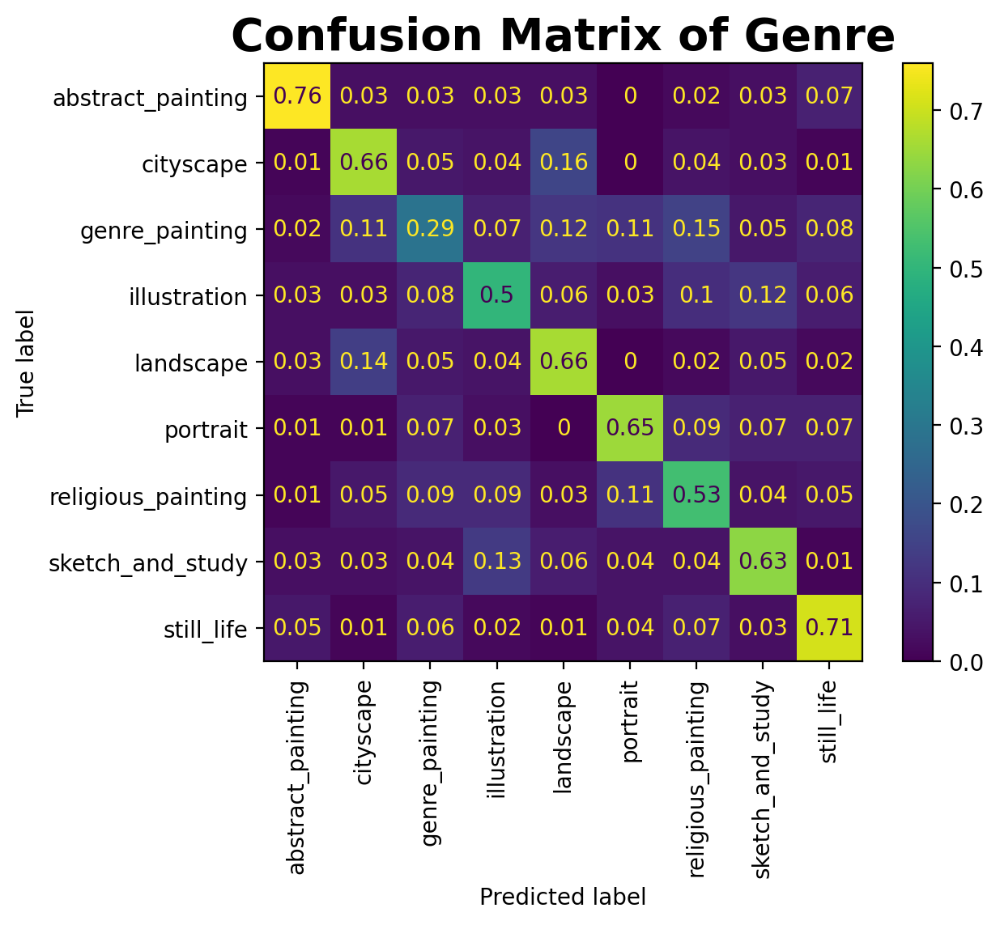

In [ ]:
from sklearn.metrics import ConfusionMatrixDisplay


# ConfusionMatrixDisplay(cm, display_labels=testset.classes).plot()

# https://gist.github.com/claudiodsf/6596204#file-np_divide-py-L8
cm_ratio = cm / cm.sum(axis=1)[:, np.newaxis]
cm_ratio = cm_ratio.round(2)
# cm_ratio.sum(axis=1)
fig, ax = plt.subplots(1,1 ,dpi=200)
ConfusionMatrixDisplay(cm_ratio, display_labels=testset.classes).plot(ax=ax)
plt.axes(ax)
plt.xticks(rotation= 90)
plt.title('Confusion Matrix of Genre' , fontsize=20, fontweight = 'bold')

In [ ]:
import random
images = trainsetorigin.imgs


# images = random.sample(images, 20)
df = pd.DataFrame(images)
df.columns = ['location', 'label']

df


,location,label
0,../data/wiki_image/genre_train/abstract_painti...,0
1,../data/wiki_image/genre_train/abstract_painti...,0
2,../data/wiki_image/genre_train/abstract_painti...,0
3,../data/wiki_image/genre_train/abstract_painti...,0
4,../data/wiki_image/genre_train/abstract_painti...,0
...,...,...
45498,../data/wiki_image/genre_train/still_life/zina...,9
45499,../data/wiki_image/genre_train/still_life/zina...,9
45500,../data/wiki_image/genre_train/still_life/zina...,9
45501,../data/wiki_image/genre_train/still_life/zina...,9


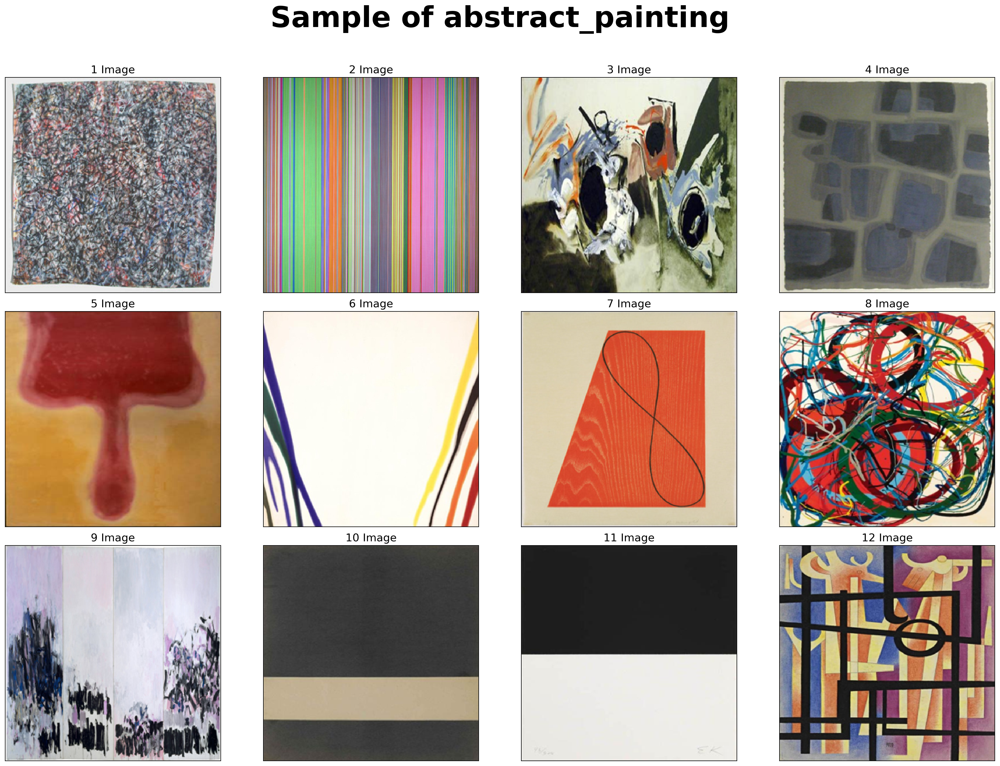

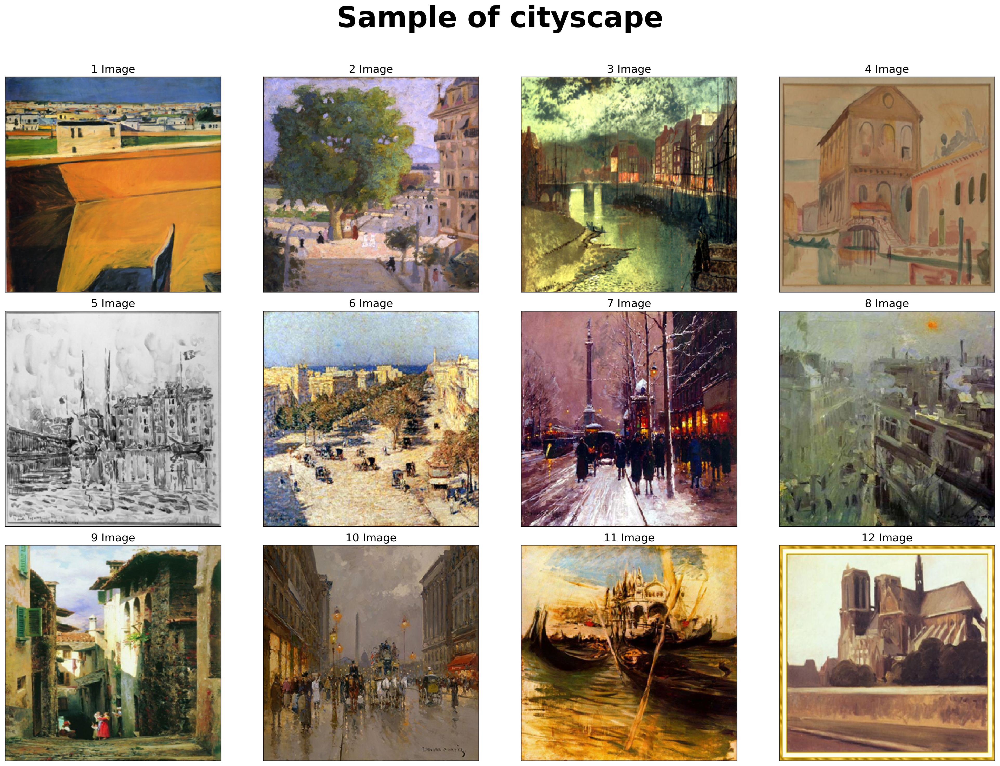

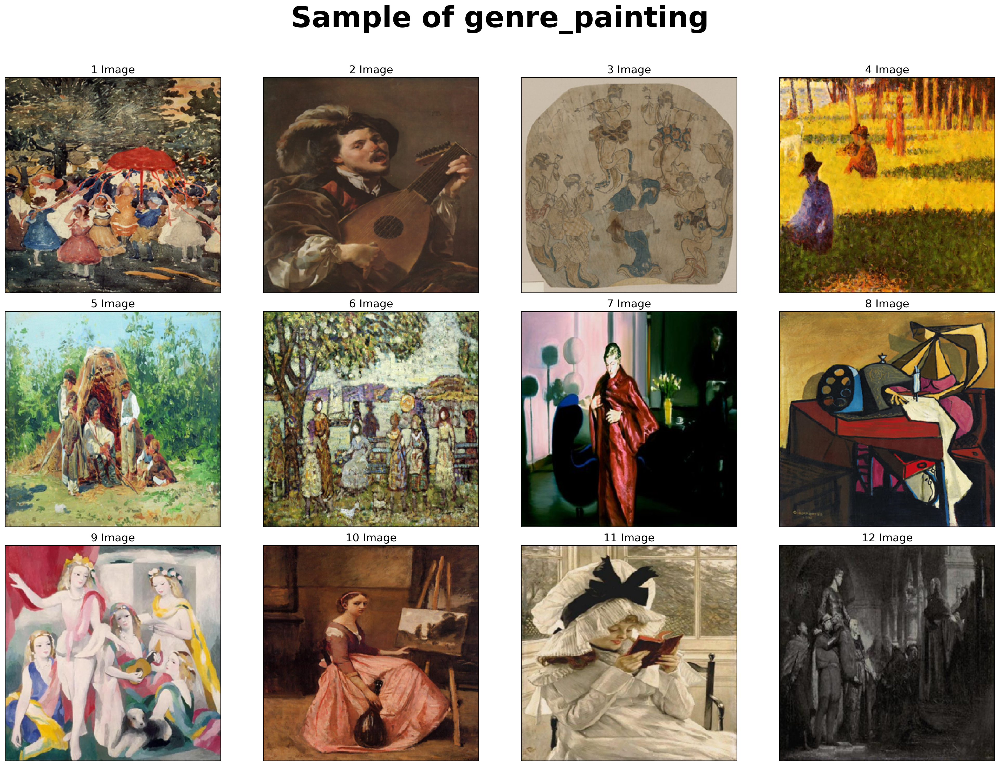

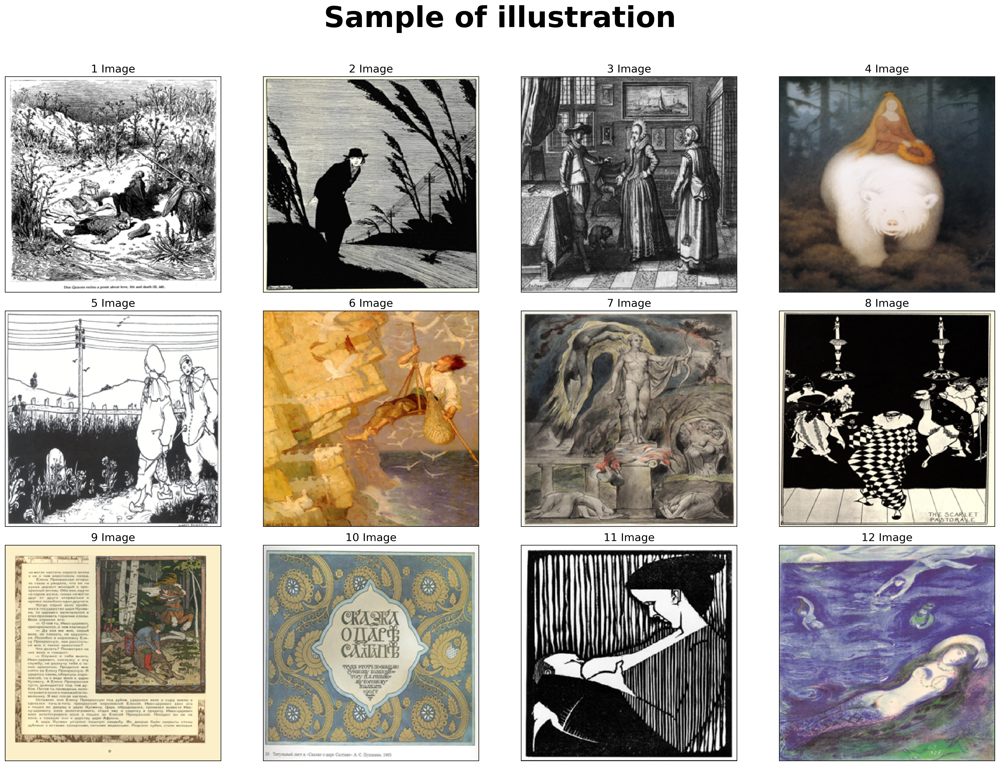

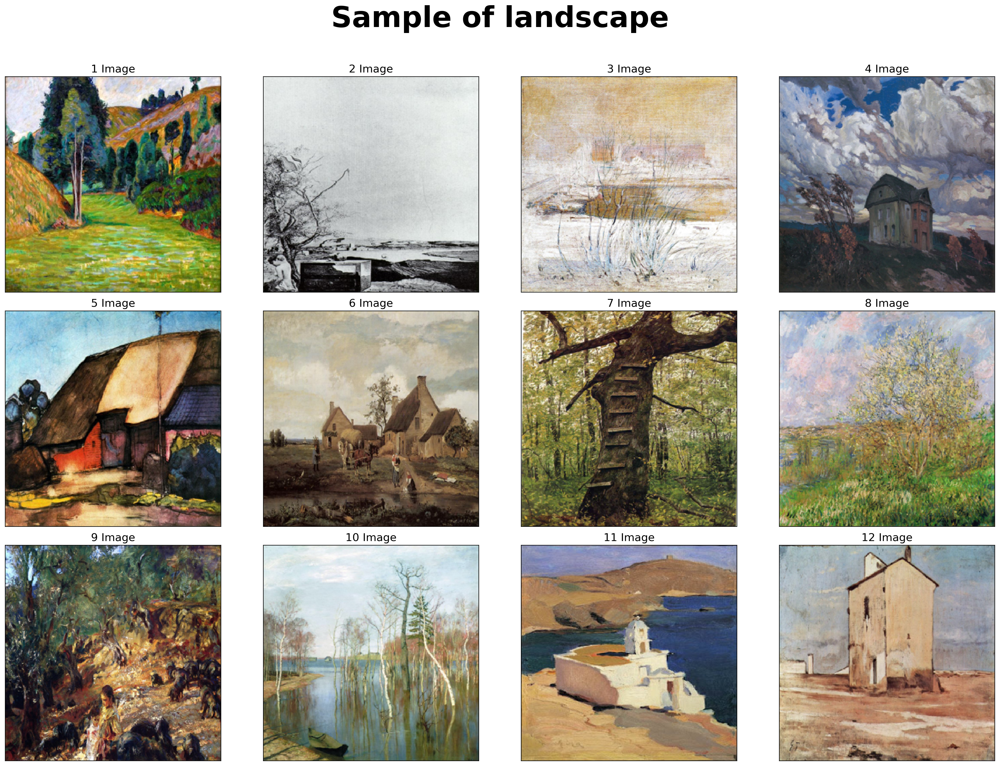

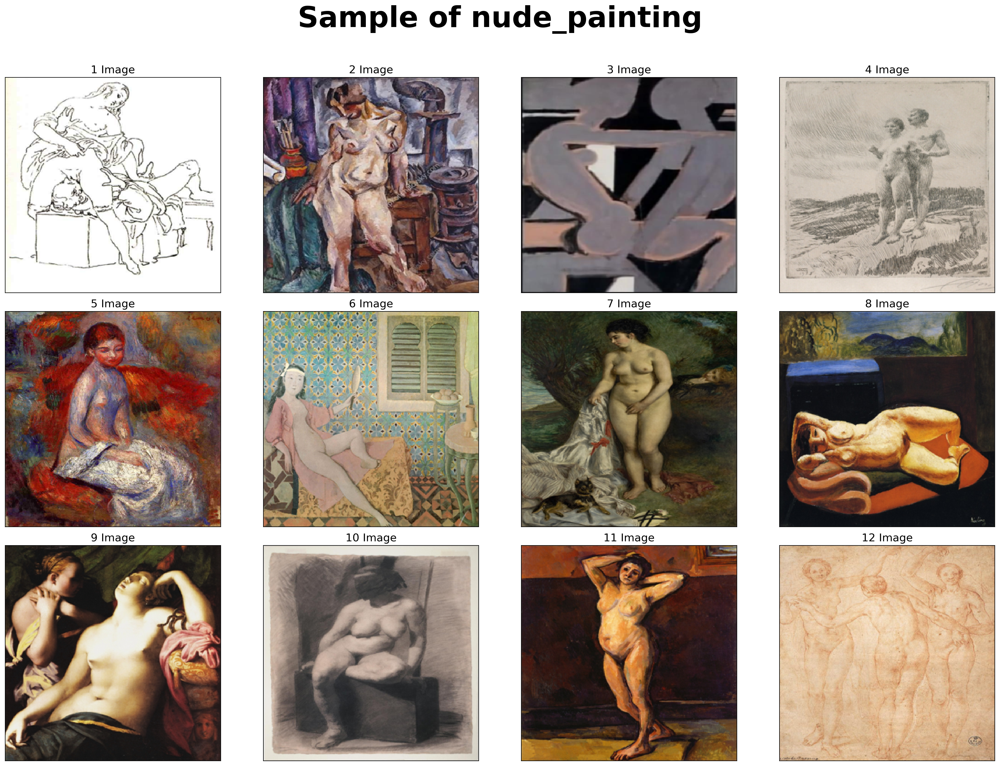

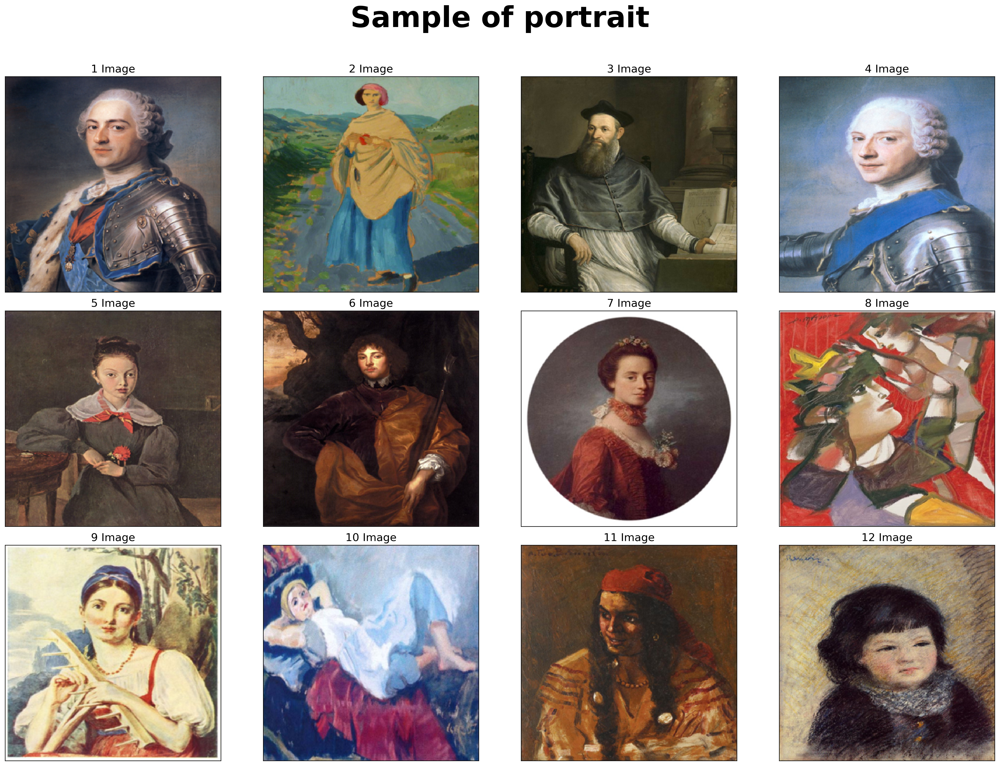

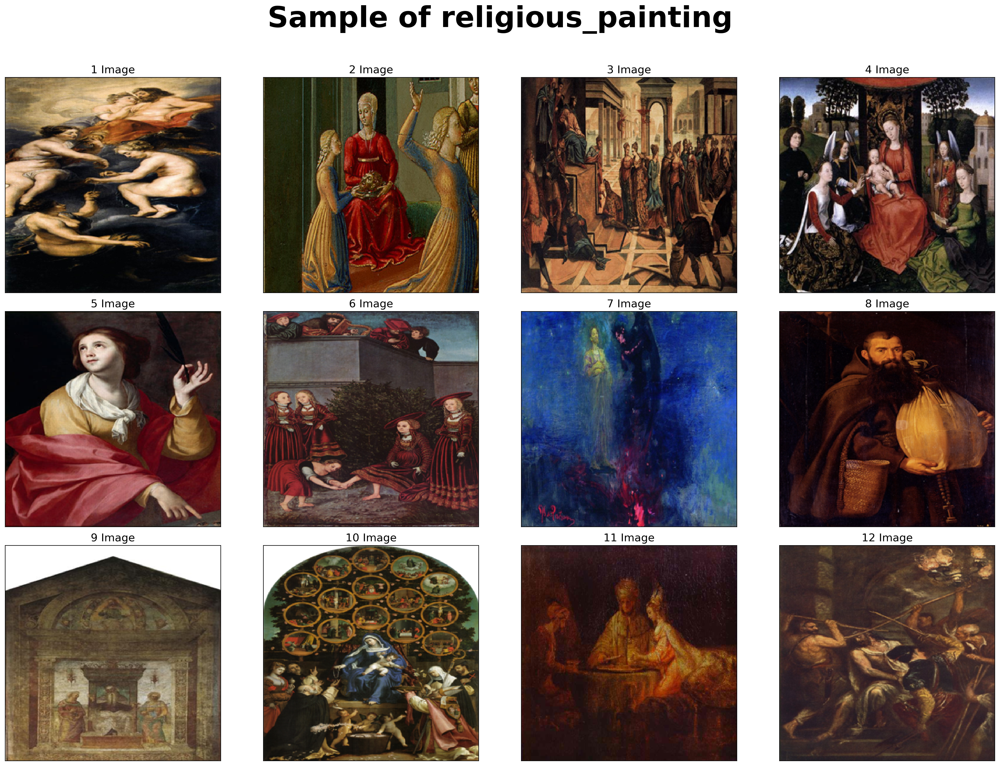

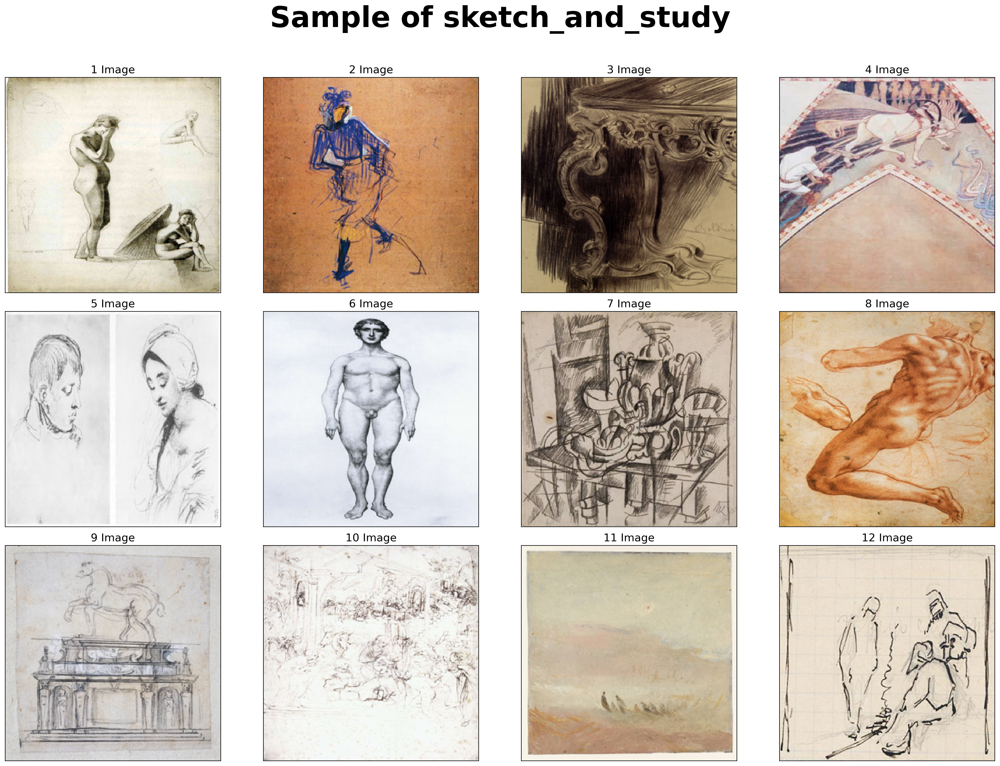

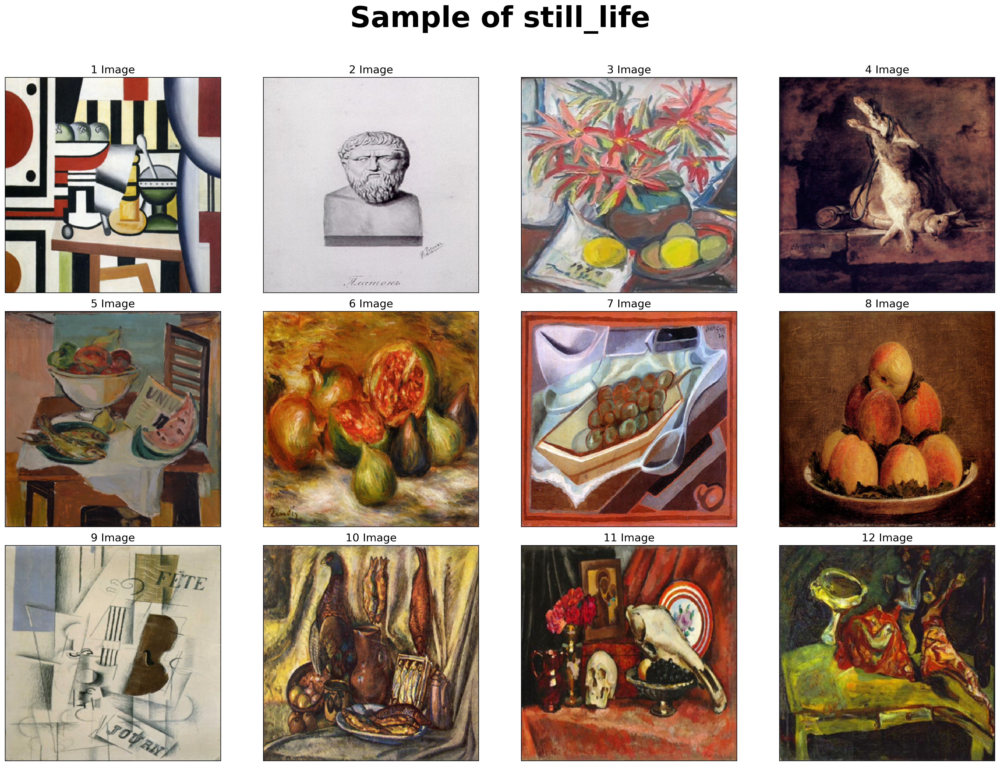

In [ ]:

from PIL import Image

def show_layer(trainset,div,title):
    num = trainset.__len__()
    row = num // div + 1 if num % div >= 1 else num // div
    fig, ax = plt.subplots(row, div, figsize=(div * 5, row * 5), dpi = 200)
    fig.suptitle(title, fontsize=40, fontweight = 'bold')
    for idx, data  in enumerate(trainset):
        plt.axes(ax[idx//div, idx%div])
        plt.imshow(Image.open(data).resize((256,256)))
        plt.title(f'{idx+1} Image', fontsize=15)
        plt.grid(False)
        plt.xticks([])
        plt.yticks([])
    plt.tight_layout()
    plt.show()
labels = trainsetorigin.classes
# labels.remove('nude_painting')
for idx, label in enumerate(labels):
    show_layer(df[df['label'] == idx].sample(12)['location'].tolist(), 4,f"Sample of {label}\n")


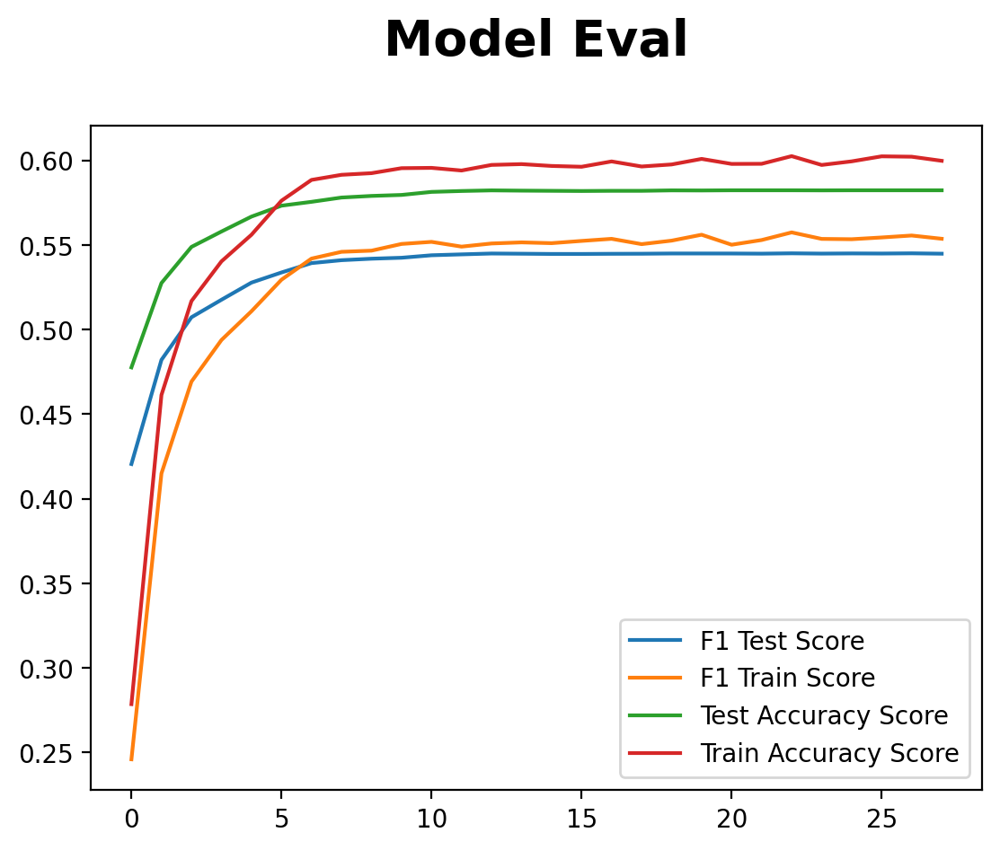

28


In [ ]:
plottarget = [
    f1,
    acc,
    train_loss,
    test_loss,
]
plt.figure(dpi=200)
plt.plot(f1, label='F1 Test Score')
plt.plot(f1_train, label='F1 Train Score')
plt.plot(acc, label='Test Accuracy Score')
plt.plot(acc_train, label='Train Accuracy Score')
plt.legend()
plt.title("Model Eval\n", fontsize = 20, fontweight = 'bold')
plt.show()
print(test_loss.__len__())

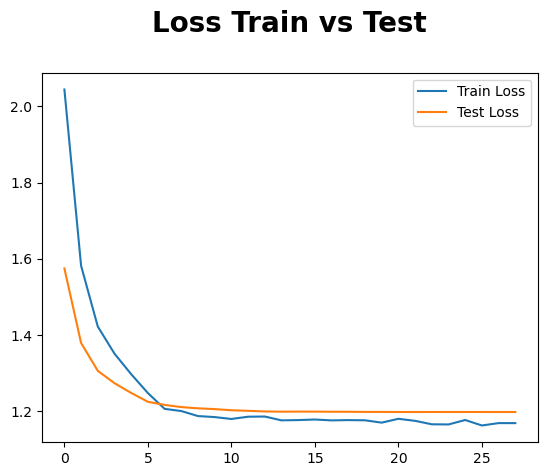

In [ ]:
plt.plot(train_loss, label="Train Loss")
plt.plot(test_loss, label="Test Loss")
plt.title('Loss Train vs Test\n', fontsize=20, fontweight = 'bold')
plt.legend()
plt.show()

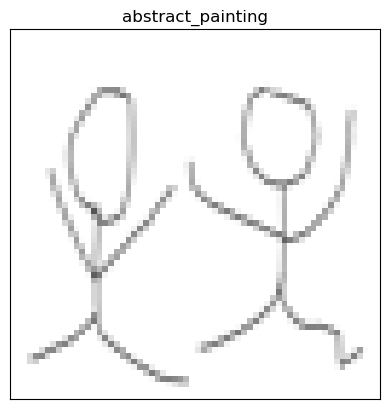

In [ ]:
# use Model

from PIL import Image
import cv2

def predict(loc, ax):
    image = Image.open(loc).resize((64,64)).convert("RGB")
    imageori = image.copy()
    imageT = preprocess_vgg11(imageori).to(DEVICE)
    imageT = imageT.unsqueeze(0)

    result = trainset.classes[torch.max(model(imageT), dim=1)[-1].item()]

    plt.axes(ax)
    plt.imshow(imageori)
    plt.title(result)
    plt.grid(False)
    plt.xticks([])
    plt.yticks([])
    plt.show()

fig, ax = plt.subplots(1,1)
predict('./predict.png', ax)
    

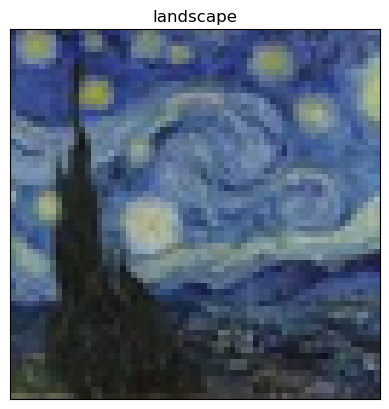

In [ ]:
fig, ax = plt.subplots(1,1)
predict('./star.jpg', ax)

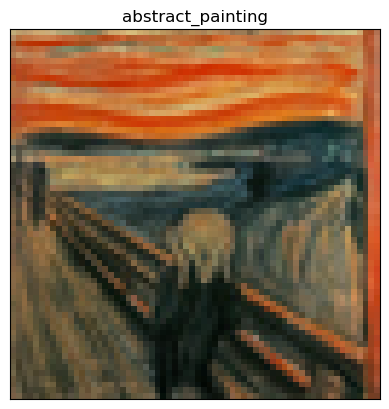

In [ ]:
fig, ax = plt.subplots(1,1)
predict('./scream.jpg', ax)